In [34]:
import visual_behavior_glm.src.GLM_params as glm_params
import visual_behavior_glm.src.GLM_analysis_tools as gat
import visual_behavior_glm.src.GLM_visualization_tools as gvt
from visual_behavior_glm.src.glm import GLM
import matplotlib.pyplot as plt
import visual_behavior.data_access.loading as loading
import visual_behavior.database as db
import plotly.express as px

import pandas as pd
import numpy as np
import os

import seaborn as sns

import visual_behavior.plotting as vbp

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import umap

In [2]:
%matplotlib notebook
%widescreen

applied a custom magic command to make full use of screen width
will only work if command is defined locally
replace with the following to replicate functionality: 
	from IPython.core.display import display, HTML
	display(HTML("<style>.container { width:100% !important; }</style>")


# Gather/organize data

## load the results summary for a single GLM version from mongo

In [3]:
rs = gat.retrieve_results(search_dict = {'glm_version': '6_L2_optimize_by_session'}, results_type='summary')
rs.sample(10)

,_id,dropout,absolute_change_from_full,variance_explained,variance_explained_full,fraction_change_from_full,cell_specimen_id,adj_fraction_change_from_full,adj_variance_explained,adj_variance_explained_full,...,cre_line,session_tags,failure_tags,exposure_number,model_outputs_available,location,has_events,session_number,glm_version,entry_time_utc
1614991,5f4fd7c7571429e3d56c3b20,single-image6,-0.015921,0.000246,0.016167,0.000000,1016956819,0.000000,0.003310,0.000000,...,Slc17a7-IRES2-Cre,NaN,NaN,0,0,Slc17a7_VISal_163,1,4,6_L2_optimize_by_session,2020-09-02 17:35:03.612682
536505,5f4fd1beef0630d2d1d8c6f6,running,0.000566,0.020970,0.020404,0.000000,1028819114,0.000000,0.020950,0.020376,...,Slc17a7-IRES2-Cre,NaN,NaN,0,0,Slc17a7_VISp_273,0,2,6_L2_optimize_by_session,2020-09-02 17:09:18.948977
2436727,5f515d14487c8a7f6b6455da,image5,-0.065110,0.242493,0.307603,-0.211670,1017242868,-0.298745,0.291811,0.416127,...,Slc17a7-IRES2-Cre,NaN,NaN,1,1,Slc17a7_VISl_259,0,3,6_L2_optimize_by_session,2020-09-03 21:16:04.178880
272542,5f4fd19cd33f4eeed70debe0,single-pre_lick_bouts,-0.006827,0.000000,0.006827,0.000000,1028808059,0.000000,0.000000,0.000000,...,Slc17a7-IRES2-Cre,NaN,NaN,0,0,Slc17a7_VISp_179,1,5,6_L2_optimize_by_session,2020-09-02 17:08:44.622038
12761,5f4fcc63ee2d7306e79b8fcd,single-post_lick_bouts,-0.005459,0.001077,0.006535,0.000000,962641359,0.000000,0.004943,0.005471,...,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISp_175,1,3,6_L2_optimize_by_session,2020-09-02 16:46:27.495169
1237204,5f4fd7181e6c39dec28dd567,model_bias,-0.000276,0.000960,0.001236,0.000000,1018066507,0.000000,0.000974,0.001242,...,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISp_75,1,4,6_L2_optimize_by_session,2020-09-02 17:32:08.005524
2240051,5f51504896520401c5487cca,running,-0.000016,0.009755,0.009771,-0.001587,982749819,-0.001603,0.009764,0.009779,...,Slc17a7-IRES2-Cre,NaN,NaN,0,0,Slc17a7_VISp_271,0,1,6_L2_optimize_by_session,2020-09-03 20:21:28.576007
1070480,5f4fd258f1e1032d2e581101,single-pre_licks,-0.101960,0.015361,0.117322,-0.130934,962618340,-0.143938,0.017012,0.118193,...,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISp_375,0,4,6_L2_optimize_by_session,2020-09-02 17:11:52.843634
2332061,5f5156db51553ad34abaae33,omissions,-0.002215,0.040725,0.042940,-0.051587,1017236350,-0.169122,0.043617,0.052494,...,Slc17a7-IRES2-Cre,NaN,NaN,1,1,Slc17a7_VISl_75,0,3,6_L2_optimize_by_session,2020-09-03 20:49:31.592440
2873993,5f51dc5fef79577fd5454894,single-hits,-0.105949,0.004322,0.110270,0.000000,962590441,-1.000000,0.094066,0.091525,...,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISp_375,0,6,6_L2_optimize_by_session,2020-09-04 06:19:11.424632


## get a list of columns to use for clustering. Defining this list now makes it easier to avoid accidentally clustering on some identifying feature (e.g., cre_line, session_type, etc.)
I'm removing the 'visual' dropout, since it's actually a combination of the omission and all-images dropouts.

In [4]:
cols_for_clustering = list(rs['dropout'].unique())
cols_for_clustering.remove('visual')
cols_for_clustering

['Full',
 'all-images',
 'beh_model',
 'change',
 'correct_rejects',
 'false_alarms',
 'hits',
 'image0',
 'image1',
 'image2',
 'image3',
 'image4',
 'image5',
 'image6',
 'image7',
 'image_expectation',
 'intercept',
 'misses',
 'model_bias',
 'model_omissions1',
 'model_task0',
 'model_timing1D',
 'omissions',
 'post_lick_bouts',
 'post_licks',
 'pre_lick_bouts',
 'pre_licks',
 'pupil',
 'rewards',
 'running',
 'single-all-images',
 'single-beh_model',
 'single-change',
 'single-correct_rejects',
 'single-false_alarms',
 'single-hits',
 'single-image0',
 'single-image1',
 'single-image2',
 'single-image3',
 'single-image4',
 'single-image5',
 'single-image6',
 'single-image7',
 'single-image_expectation',
 'single-misses',
 'single-model_bias',
 'single-model_omissions1',
 'single-model_task0',
 'single-model_timing1D',
 'single-omissions',
 'single-post_lick_bouts',
 'single-post_licks',
 'single-pre_lick_bouts',
 'single-pre_licks',
 'single-pupil',
 'single-rewards',
 'single-run

## build a pivoted version of the results summary, using the `fraction_change_from_full` column as the values.

In [5]:
rsp = gat.build_pivoted_results_summary(results_summary=rs, cutoff=0.01, value_to_use='fraction_change_from_full')

## add a `session_id` column with a numeric value for the session_type (to lump together sessions by order, regardless of image set)

In [6]:
def map_session_types(session_type):
    session_id = int(session_type[6:7])
    return session_id
rsp['session_id'] = rsp['session_type'].map(lambda st:map_session_types(st))

rsp

,identifier,Full,all-images,beh_model,change,correct_rejects,face_motion_energy,false_alarms,hits,image0,...,cre_line,session_tags,failure_tags,exposure_number,model_outputs_available,location,has_events,session_number,glm_version,session_id
0,1000743008_1003146172,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.045291,-0.000224,-0.002191,-0.005937,...,Sst-IRES-Cre,NaN,NaN,0,1,Sst_VISp_275,0,1,6_L2_optimize_by_session,1
1,1000743008_1003146172,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.045291,-0.000224,-0.002191,-0.005937,...,Sst-IRES-Cre,NaN,NaN,0,1,Sst_VISp_275,0,1,6_L2_optimize_by_session,1
2,1000743008_1003146172,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.045291,-0.000224,-0.002191,-0.005937,...,Sst-IRES-Cre,NaN,NaN,0,1,Sst_VISp_275,0,1,6_L2_optimize_by_session,1
3,1000743008_1003146172,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.045291,-0.000224,-0.002191,-0.005937,...,Sst-IRES-Cre,NaN,NaN,0,1,Sst_VISp_275,0,1,6_L2_optimize_by_session,1
4,1000743008_1003146172,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.045291,-0.000224,-0.002191,-0.005937,...,Sst-IRES-Cre,NaN,NaN,0,1,Sst_VISp_275,0,1,6_L2_optimize_by_session,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2391198,995622557_994310003,0.0,-0.855131,NaN,-0.000231,-0.000474,-0.036676,NaN,NaN,-0.011608,...,Sst-IRES-Cre,NaN,NaN,0,0,Sst_VISp_275,1,5,6_L2_optimize_by_session,5
2391199,995622557_994310003,0.0,-0.855131,NaN,-0.000231,-0.000474,-0.036676,NaN,NaN,-0.011608,...,Sst-IRES-Cre,NaN,NaN,0,0,Sst_VISp_275,1,5,6_L2_optimize_by_session,5
2391200,995622557_994310003,0.0,-0.855131,NaN,-0.000231,-0.000474,-0.036676,NaN,NaN,-0.011608,...,Sst-IRES-Cre,NaN,NaN,0,0,Sst_VISp_275,1,5,6_L2_optimize_by_session,5
2391201,995622557_994310003,0.0,-0.855131,NaN,-0.000231,-0.000474,-0.036676,NaN,NaN,-0.011608,...,Sst-IRES-Cre,NaN,NaN,0,0,Sst_VISp_275,1,5,6_L2_optimize_by_session,5


## Turn some categorical columns into numerical columns

In [8]:
def make_categorical(df, column):
    df['{}_categorical'.format(column)] = pd.Categorical(df[column], ordered=True).codes

for column in ['cre_line','equipment_name','targeted_structure','session_id']:
    make_categorical(rsp, column)


In [9]:
rsp[cols_for_clustering].fillna(0)

,Full,all-images,beh_model,change,correct_rejects,false_alarms,hits,image0,image1,image2,...,single-pre_lick_bouts,single-pre_licks,single-pupil,single-rewards,single-running,single-time,single-visual,time,face_motion_energy,single-face_motion_energy
0,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.000224,-0.002191,-0.005937,-0.000383,0.000000,...,-0.142746,-0.108625,-0.171821,-0.073635,0.0,0.0,-0.666971,0.000000,-0.045291,-0.249236
1,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.000224,-0.002191,-0.005937,-0.000383,0.000000,...,-0.142746,-0.108625,-0.171821,-0.073635,0.0,0.0,-0.666971,0.000000,-0.045291,-0.249236
2,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.000224,-0.002191,-0.005937,-0.000383,0.000000,...,-0.142746,-0.108625,-0.171821,-0.073635,0.0,0.0,-0.666971,0.000000,-0.045291,-0.249236
3,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.000224,-0.002191,-0.005937,-0.000383,0.000000,...,-0.142746,-0.108625,-0.171821,-0.073635,0.0,0.0,-0.666971,0.000000,-0.045291,-0.249236
4,0.0,-0.136069,-0.003499,-0.004896,-0.000129,-0.000224,-0.002191,-0.005937,-0.000383,0.000000,...,-0.142746,-0.108625,-0.171821,-0.073635,0.0,0.0,-0.666971,0.000000,-0.045291,-0.249236
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2391198,0.0,-0.855131,0.000000,-0.000231,-0.000474,0.000000,0.000000,-0.011608,-0.029650,-0.007593,...,0.000000,0.000000,0.000000,0.000000,0.0,0.0,-0.903712,-0.004981,-0.036676,-0.018237
2391199,0.0,-0.855131,0.000000,-0.000231,-0.000474,0.000000,0.000000,-0.011608,-0.029650,-0.007593,...,0.000000,0.000000,0.000000,0.000000,0.0,0.0,-0.903712,-0.004981,-0.036676,-0.018237
2391200,0.0,-0.855131,0.000000,-0.000231,-0.000474,0.000000,0.000000,-0.011608,-0.029650,-0.007593,...,0.000000,0.000000,0.000000,0.000000,0.0,0.0,-0.903712,-0.004981,-0.036676,-0.018237
2391201,0.0,-0.855131,0.000000,-0.000231,-0.000474,0.000000,0.000000,-0.011608,-0.029650,-0.007593,...,0.000000,0.000000,0.000000,0.000000,0.0,0.0,-0.903712,-0.004981,-0.036676,-0.018237


In [25]:
rsp_sample = rsp.sample(100000, random_state=0)

# Dimensionality reduction and clustering
So many more things to try here. This is just a start.

## PCA

In [51]:
pca = PCA(n_components=40)
pca_result = pca.fit_transform(rsp_sample [cols_for_clustering].fillna(0).values)
rsp_sample ['pc1'] = pca_result[:,0]
rsp_sample ['pc2'] = pca_result[:,1] 
rsp_sample ['pc3'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [0.36226933 0.12167376 0.04893662 0.04578283 0.04337737 0.04207761
 0.04164502 0.04081624 0.03907747 0.03848054 0.03586125 0.02798973
 0.02239486 0.02165235 0.01211859 0.00695211 0.0053284  0.00464021
 0.00402891 0.00389076 0.00369257 0.00317859 0.0028747  0.0025792
 0.00237459 0.00175819 0.00134642 0.00120813 0.00099971 0.00090408
 0.00087269 0.00080426 0.00077723 0.00074871 0.00074554 0.00071553
 0.00055159 0.00052275 0.00049252 0.0004658 ]


In [52]:
np.cumsum(pca.explained_variance_ratio_)

array([0.36226933, 0.48394309, 0.53287972, 0.57866255, 0.62203992,
       0.66411752, 0.70576254, 0.74657878, 0.78565626, 0.82413679,
       0.85999804, 0.88798777, 0.91038263, 0.93203498, 0.94415357,
       0.95110568, 0.95643408, 0.96107429, 0.9651032 , 0.96899396,
       0.97268653, 0.97586513, 0.97873983, 0.98131903, 0.98369361,
       0.98545181, 0.98679823, 0.98800636, 0.98900607, 0.98991014,
       0.99078283, 0.99158709, 0.99236433, 0.99311303, 0.99385857,
       0.99457411, 0.9951257 , 0.99564844, 0.99614096, 0.99660676])

<IPython.core.display.Javascript object>


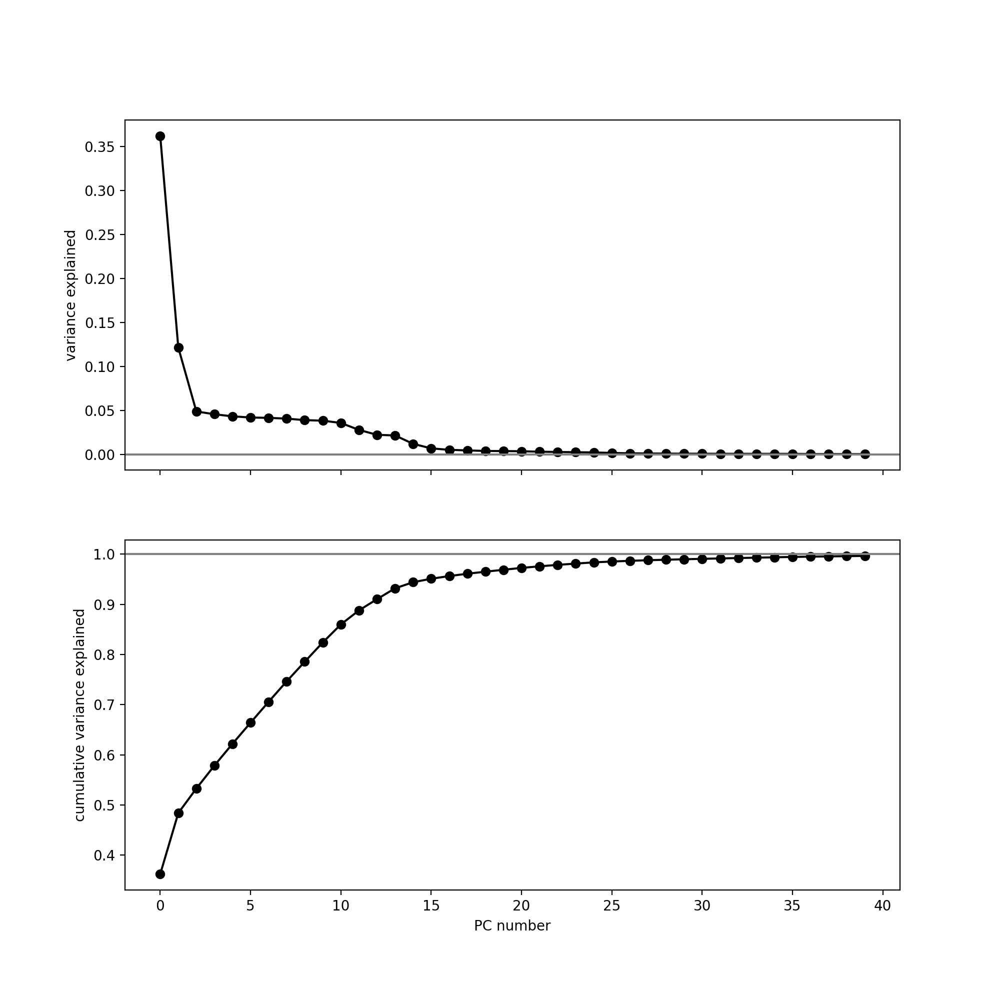

Text(0, 0.5, 'cumulative variance explained')

In [55]:
fig,ax=plt.subplots(2,1,figsize=(10,10), sharex=True)
ax[0].plot(
    np.arange(40),
    pca.explained_variance_ratio_,
    'o-k'
)
ax[1].plot(
    np.arange(40),
    np.cumsum(pca.explained_variance_ratio_),
    'o-k'
)

ax[0].axhline(0, color='gray')
ax[1].axhline(1, color='gray')
ax[1].set_xlabel('PC number')
ax[0].set_ylabel('variance explained')
ax[1].set_ylabel('cumulative variance explained')

In [94]:
sorted_cols = np.array(cols_for_clustering)[np.argsort(pca.components_[0,:])]
sorted_cols

array(['single-running', 'single-face_motion_energy', 'single-pupil',
       'single-post_licks', 'running', 'single-pre_licks',
       'face_motion_energy', 'single-post_lick_bouts', 'pupil',
       'single-pre_lick_bouts', 'single-rewards', 'single-hits',
       'omissions', 'post_licks', 'intercept', 'beh_model',
       'single-beh_model', 'post_lick_bouts', 'time', 'single-time',
       'pre_lick_bouts', 'single-model_omissions1', 'single-model_task0',
       'single-model_bias', 'pre_licks', 'single-model_timing1D',
       'rewards', 'model_omissions1', 'model_task0', 'model_timing1D',
       'model_bias', 'hits', 'change', 'misses', 'correct_rejects',
       'false_alarms', 'Full', 'single-false_alarms',
       'single-correct_rejects', 'single-omissions', 'single-change',
       'image_expectation', 'single-misses', 'image6', 'image3', 'image2',
       'image7', 'image1', 'image5', 'image0', 'image4', 'single-image3',
       'single-image6', 'single-image2', 'single-image5', 'si

In [97]:
components = pd.DataFrame(pca.components_, columns=cols_for_clustering)
components[sorted_cols[::-1]]

,single-all-images,single-visual,all-images,single-image_expectation,single-image4,single-image0,single-image7,single-image1,single-image5,single-image2,...,single-pre_lick_bouts,pupil,single-post_lick_bouts,face_motion_energy,single-pre_licks,running,single-post_licks,single-pupil,single-face_motion_energy,single-running
0,0.558709,0.537358,0.371955,0.191074,0.071108,0.068420,0.065419,0.063948,0.062014,0.059471,...,-0.037838,-0.038394,-0.046096,-0.047822,-0.057508,-0.076240,-0.093299,-0.112377,-0.253789,-0.280190
1,-0.074329,-0.091484,0.587491,-0.700512,0.028071,0.041966,0.045158,0.051400,0.055952,0.062568,...,-0.016317,-0.021800,0.015356,0.023605,0.013205,0.033064,0.030990,-0.249502,0.083477,0.101340
2,0.067173,0.071543,-0.127765,0.203069,-0.136573,0.009640,0.091110,0.022612,-0.034991,-0.003887,...,0.098566,-0.235214,0.093717,-0.009755,0.128937,0.090628,0.179227,-0.765747,0.041166,0.381598
3,-0.024848,0.000756,-0.000206,-0.033133,-0.735200,0.412813,0.136781,-0.097049,0.078725,0.078048,...,-0.022483,0.044330,-0.021362,0.000039,-0.030272,-0.013024,-0.037804,0.100045,-0.038005,-0.081310
4,-0.024493,0.012941,-0.012290,-0.011963,-0.306417,-0.682500,0.113310,0.169617,0.370304,0.099059,...,-0.015106,0.014345,-0.009262,0.000558,-0.016615,-0.006190,-0.017172,0.014353,-0.033419,-0.056078
5,0.005893,-0.021933,0.012274,-0.019159,-0.052643,-0.167245,0.528798,0.163159,-0.628578,0.158222,...,-0.016696,0.025933,-0.010844,0.007975,-0.016810,-0.014198,-0.022964,0.075297,0.022946,-0.060066
6,-0.005089,0.008545,-0.007974,-0.013437,0.159241,-0.057998,0.478613,-0.677730,0.211384,-0.032834,...,-0.002352,0.000220,-0.002784,0.001333,-0.006303,0.000447,-0.006370,-0.014248,0.008792,-0.007163
7,0.022002,-0.008338,0.022567,0.003175,0.018682,0.116220,0.360990,0.369534,0.229208,-0.549698,...,0.013969,0.004450,0.004090,0.000070,0.008234,-0.009719,0.004861,0.062338,0.047786,0.024531
8,-0.028066,0.008753,-0.019134,-0.016918,0.025101,0.011309,-0.005795,0.055328,0.133449,0.458179,...,-0.015063,0.010191,-0.009307,-0.000079,-0.015649,0.005135,-0.021994,-0.010141,-0.032018,-0.034899
9,0.034420,-0.002377,0.006308,0.040635,0.027784,0.074130,0.038763,0.080853,0.065423,0.312148,...,0.013195,-0.029232,0.017507,-0.005121,0.025130,0.007931,0.036344,-0.015587,0.025839,0.080722


<IPython.core.display.Javascript object>


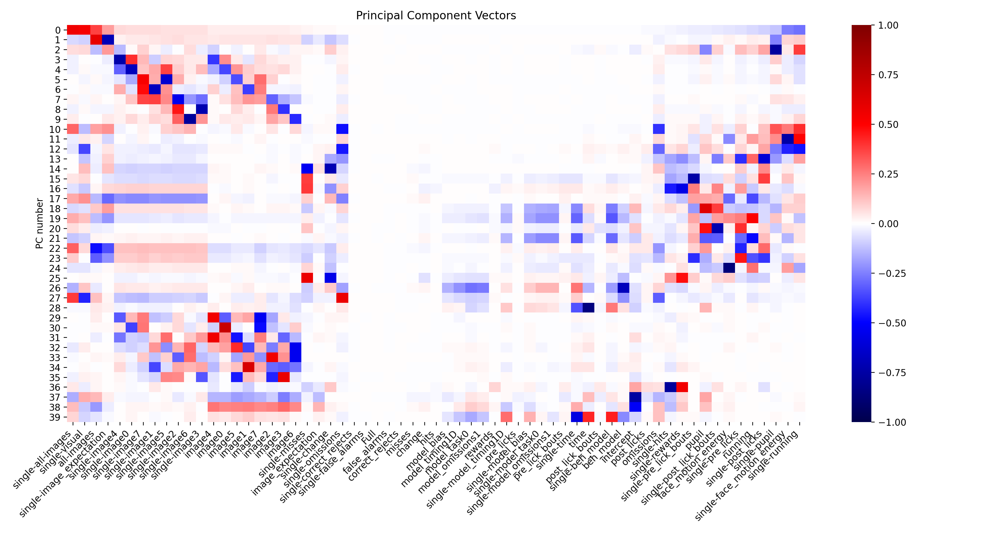

In [100]:
fig,ax=plt.subplots(figsize=(15,8))
sns.heatmap(
    components[sorted_cols[::-1]],
    cmap='seismic',
    ax=ax,
    vmin=-1,
    vmax=1
)
ax.set_title('Principal Component Vectors')
ax.set_xticks(np.arange(0.5,len(cols_for_clustering)+0.5))
ax.set_xticklabels(sorted_cols[::-1],rotation=45,ha='right')
ax.set_ylabel('PC number')
fig.tight_layout()

In [56]:
dir(pca)

['__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_check_n_features',
 '_fit',
 '_fit_full',
 '_fit_svd_solver',
 '_fit_truncated',
 '_get_param_names',
 '_get_tags',
 '_more_tags',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_validate_data',
 'components_',
 'copy',
 'explained_variance_',
 'explained_variance_ratio_',
 'fit',
 'fit_transform',
 'get_covariance',
 'get_params',
 'get_precision',
 'inverse_transform',
 'iterated_power',
 'mean_',
 'n_components',
 'n_components_',
 'n_features_',
 'n_features_in_',
 'n_samples_',
 'noise_variance_',
 'random_state',
 'score',
 'scor

<IPython.core.display.Javascript object>


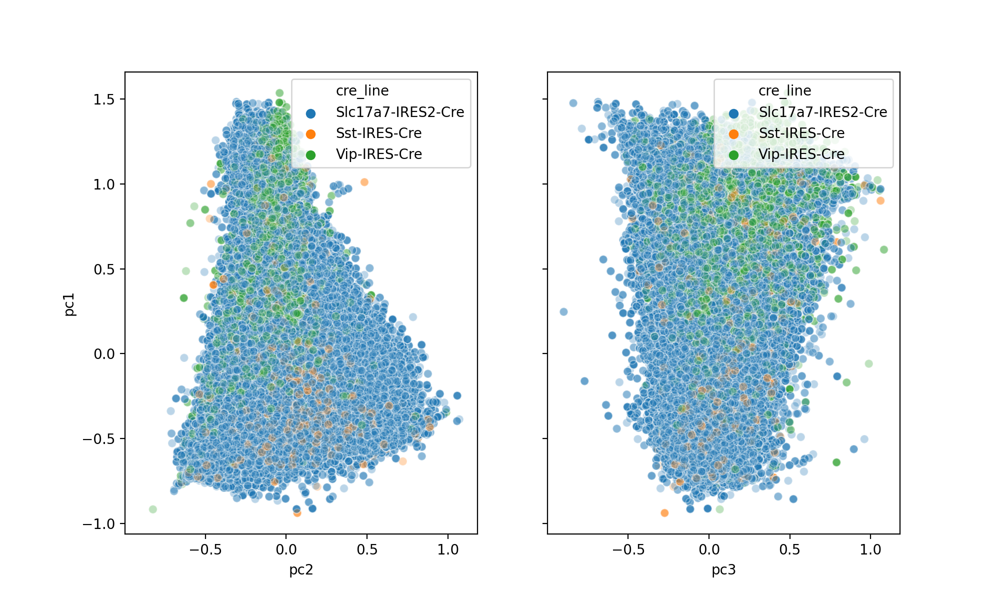

In [44]:
fig,ax=plt.subplots(1,2,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x='pc2', 
    y='pc1',
    hue='cre_line',
#     palette=sns.color_palette("hsv",3),
    data=rsp_sample,
#     legend='full',
    alpha=0.3,
    ax=ax[0],
)
sns.scatterplot(
    x='pc3', 
    y='pc1',
    hue='cre_line',
#     palette=sns.color_palette("hsv", 3),
    data=rsp_sample,
#     legend='full',
    alpha=0.3,
    ax=ax[1],
)

In [43]:
fig = px.scatter_3d(
    rsp_sample, 
    x='pc1', 
    y='pc2',
    z='pc3',
    color='cre_line',
    color_continuous_scale='hsv',
)


fig.update_layout(
    scene_camera=camera,
    margin=dict(l=30, r=30, t=10, b=10),
    width=1200,
    height=1000,
)
# fig.write_html("/home/dougo/code/dougollerenshaw.github.io/figures_to_share/2020.08.21_k_means_on_umap.html")
fig.show()

## UMAP
Important: see https://umap-learn.readthedocs.io/en/latest/clustering.html for a very good discussion on clustering before/after dimensionality reduction

In [11]:
reducer_2d = umap.UMAP(n_components=2)
reducer_3d = umap.UMAP(n_components=3)

In [26]:
%%time
embedding_2d = reducer_2d.fit_transform(rsp_sample[cols_for_clustering].fillna(0))

/home/dougo/.conda/envs/visual_behavior/lib/python3.8/site-packages/umap/spectral.py:252: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


CPU times: user 26min 49s, sys: 3.17 s, total: 26min 52s
Wall time: 1min 17s


In [27]:
# add umap embeddings to dataframe
rsp_sample['umap_2d_embedding_0'] = embedding_2d[:, 0]
rsp_sample['umap_2d_embedding_1'] = embedding_2d[:, 1]

In [28]:
embedding_3d = reducer_3d.fit_transform(rsp_sample[cols_for_clustering].fillna(0))

# add umap embeddings to dataframe
rsp_sample['umap_3d_embedding_0'] = embedding_3d[:, 0]
rsp_sample['umap_3d_embedding_1'] = embedding_3d[:, 1]
rsp_sample['umap_3d_embedding_2'] = embedding_3d[:, 2]

## k-means clustering on 3d umap

In [31]:

kmeans = KMeans(n_clusters=20)
umap_cols = ['umap_3d_embedding_0','umap_3d_embedding_1','umap_3d_embedding_2']
rsp_sample['k_means_on_3d_umap'] = kmeans.fit_predict(rsp_sample[umap_cols])
rsp_sample['k_means_on_3d_umap'].value_counts()

12    7632
11    7312
13    6898
2     6789
14    6362
7     5724
16    5603
3     5485
15    5164
6     4977
10    4834
0     4668
8     4525
5     4131
1     3596
19    3595
9     3391
18    3370
17    3079
4     2865
Name: k_means_on_3d_umap, dtype: int64

## visualize in 2d using matplotlib

<IPython.core.display.Javascript object>


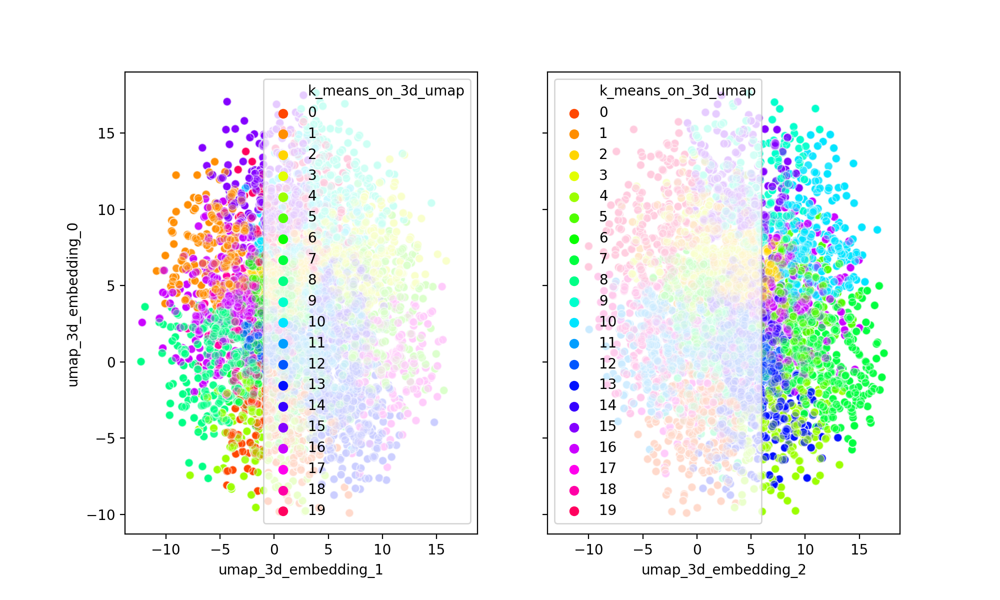

In [32]:
fig,ax=plt.subplots(1,2,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x='umap_3d_embedding_1', 
    y='umap_3d_embedding_0',
    hue='k_means_on_3d_umap',
    palette=sns.color_palette("hsv", len(rsp_sample['k_means_on_3d_umap'].unique())),
    data=rsp_sample,
    legend='full',
    alpha=0.3,
    ax=ax[0],
)
sns.scatterplot(
    x='umap_3d_embedding_2', 
    y='umap_3d_embedding_0',
    hue='k_means_on_3d_umap',
    palette=sns.color_palette("hsv", len(rsp_sample['k_means_on_3d_umap'].unique())),
    data=rsp_sample,
    legend='full',
    alpha=0.3,
    ax=ax[1],
)

## visualize in 3d using plotly

In [33]:
fig = px.scatter_3d(
    rsp_sample, 
    x='umap_3d_embedding_0', 
    y='umap_3d_embedding_1', 
    z='umap_3d_embedding_2',
    color='k_means_on_3d_umap',
    color_continuous_scale='hsv',
)

# optional view positioning parameters (I don't really understand these, just toying with them to get a view I like!)
camera = dict(
    up=dict(x=3, y=1.75, z=0.25),
    eye=dict(x=1.5, y=1.5, z=-0.2)
)

fig.update_layout(
    scene_camera=camera,
    margin=dict(l=30, r=30, t=10, b=10),
    width=1200,
    height=1000,
)
# fig.write_html("/home/dougo/code/dougollerenshaw.github.io/figures_to_share/2020.08.21_k_means_on_umap.html")
fig.show()

# A little bit of prep for plotting

## first define the dominant dropout in each cluster

In [12]:
# identify dominant dropouts for each cluster
gat.identify_dominant_dropouts(rsp, cluster_column_name='k_means_on_3d_umap', cols_to_search=cols_for_clustering)

## define heatmap parameters
lots here, but there are lots of options!

In [13]:
cols_to_plot = [
    'all-images', 
    'omissions', 
    'pupil', 
    'running',
    'cre_line_categorical', 
    'session_id_categorical', 
    'k_means_on_3d_umap', 
    'equipment_name_categorical',
    'targeted_structure_categorical',
    'imaging_depth'
]

# make sure there's a heatmap definition for every column, otherwise the column will plot without a heatmap!
heatmap_defs = [
    {
        'columns':cols_to_plot[:4],
        'cbar_label':'fraction change\nin var explained',
        'cbar_ticks':[-1,0,1],
        'vmin':-1,
        'vmax':1,
        'cmap':'bwr',
    },
    {
        'columns':['cre_line_categorical'],
        'cbar_label':'cre_line',
        'cbar_ticks':[0,1,2],
        'cbar_ticklabels':np.sort(np.unique(rsp['cre_line'])),
        'vmin':-0.5,
        'vmax':2.5,
        'cmap':sns.color_palette("hls", 3),
    },
    {
        'columns':['session_id_categorical'],
        'cbar_label':'session ID',
        'cbar_ticks':[0,1,2,3],
        'cbar_ticklabels':[1,3,4,6],
        'vmin':-0.5,
        'vmax':3.5,
        'cmap':sns.color_palette("Dark2", 4),
    },
    {
        'columns':['k_means_on_3d_umap'],
        'cbar_label':'k-means label',
        'cbar_ticks':np.arange(0,20,2),
        'vmin':0,
        'vmax':19,
        'cmap':sns.color_palette("hsv", 20),
    },
    {
        'columns':['equipment_name_categorical'],
        'cbar_label':'equipment name',
        'cbar_ticks':np.arange(len(rsp['equipment_name_categorical'].unique())),
        'cbar_ticklabels':np.sort(np.unique(rsp['equipment_name'])),
        'vmin':-0.5,
        'vmax':len(rsp['equipment_name_categorical'].unique())-0.5,
        'cmap':sns.color_palette("hls", len(rsp['equipment_name_categorical'].unique())),
    },
    {
        'columns':['targeted_structure_categorical'],
        'cbar_label':'targeted structure',
        'cbar_ticks':np.arange(len(rsp['targeted_structure_categorical'].unique())),
        'cbar_ticklabels':np.sort(np.unique(rsp['targeted_structure'])),
        'vmin':-0.5,
        'vmax':len(rsp['targeted_structure'].unique())-0.5,
        'cmap':sns.color_palette("hls", len(rsp['targeted_structure'].unique())),
    },
    {
        'columns':['imaging_depth'],
        'cbar_label':'imaging_depth',
        'cbar_ticks':[0,100,200,300,400],
        'vmin':0,
        'vmax':400,
        'cmap':'magma',
    },
]

# Make heatmaps, sort by whatever we want
Note that it only makes sense to nest sorting values for categorical data. Any sorting value that follows a continuous variable will not have any effect.

## First sort by dominant dropout, the median value of the dominant dropout (for cases with multiple clusters sharing the same dominant dropout), then cre_line, session_id, imaging_depth

<IPython.core.display.Javascript object>


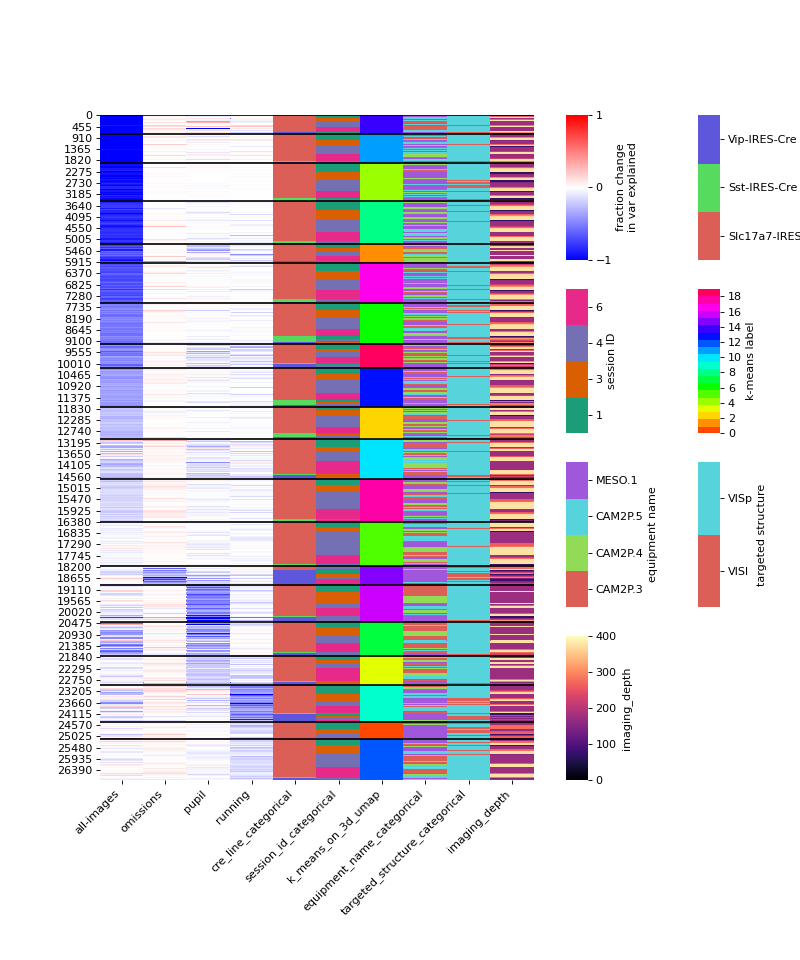

In [14]:
sort_order = ['dominant_dropout','dominant_dropout_median','cre_line_categorical','session_id_categorical','imaging_depth',]
sorted_data = gat.sort_data(rsp, sort_order, cluster_column_name='k_means_on_3d_umap')

fig, axes = vbp.make_multi_cmap_heatmap(
    sorted_data[cols_to_plot], 
    heatmap_defs, 
    figsize=(10,12), 
    top_buffer=0, 
    bottom_buffer=0.1, 
    n_cbar_rows=4, 
    heatmap_div=0.7, 
)
for idx,row in sorted_data.query('cluster_transition').iterrows():
    axes['heatmap'].axhline(idx,color='black')

## another sorting, with imaging_depth being the emphasis

<IPython.core.display.Javascript object>


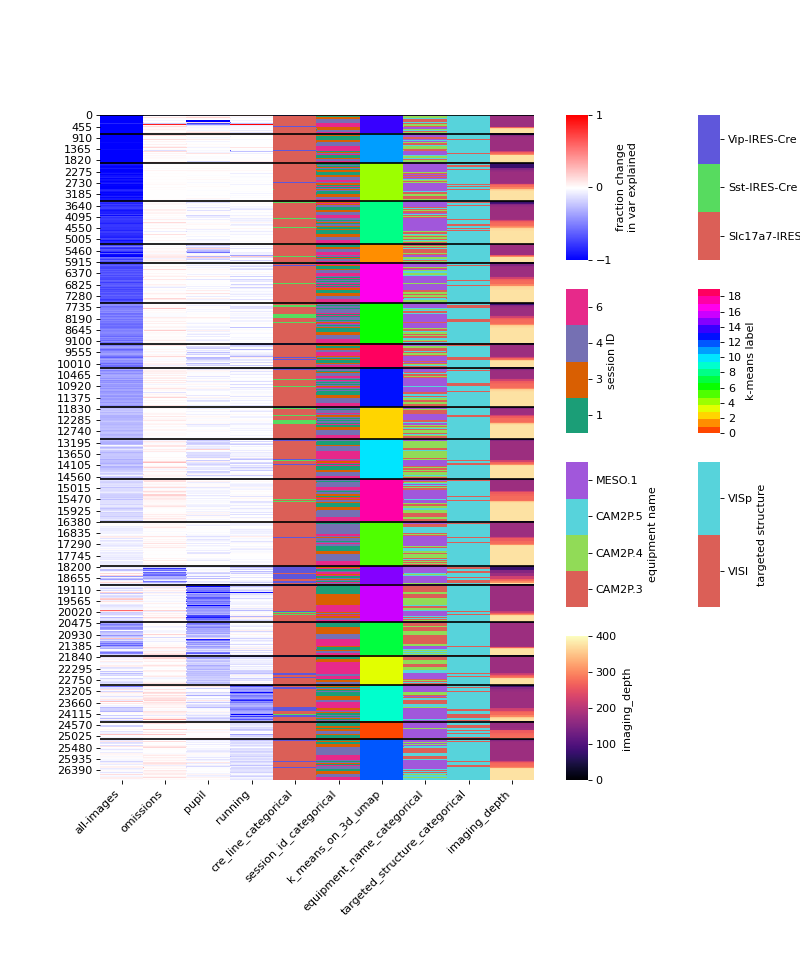

In [15]:
sort_order = ['dominant_dropout','dominant_dropout_median','imaging_depth','cre_line_categorical','session_id_categorical']
sorted_data = gat.sort_data(rsp, sort_order, cluster_column_name='k_means_on_3d_umap')

fig, axes = vbp.make_multi_cmap_heatmap(
    sorted_data[cols_to_plot], 
    heatmap_defs, 
    figsize=(10,12), 
    top_buffer=0, 
    bottom_buffer=0.1, 
    n_cbar_rows=4, 
    heatmap_div=0.7, 
)
for idx,row in sorted_data.query('cluster_transition').iterrows():
    axes['heatmap'].axhline(idx,color='black')

## and another sorting, with session_id being the emphasis

<IPython.core.display.Javascript object>


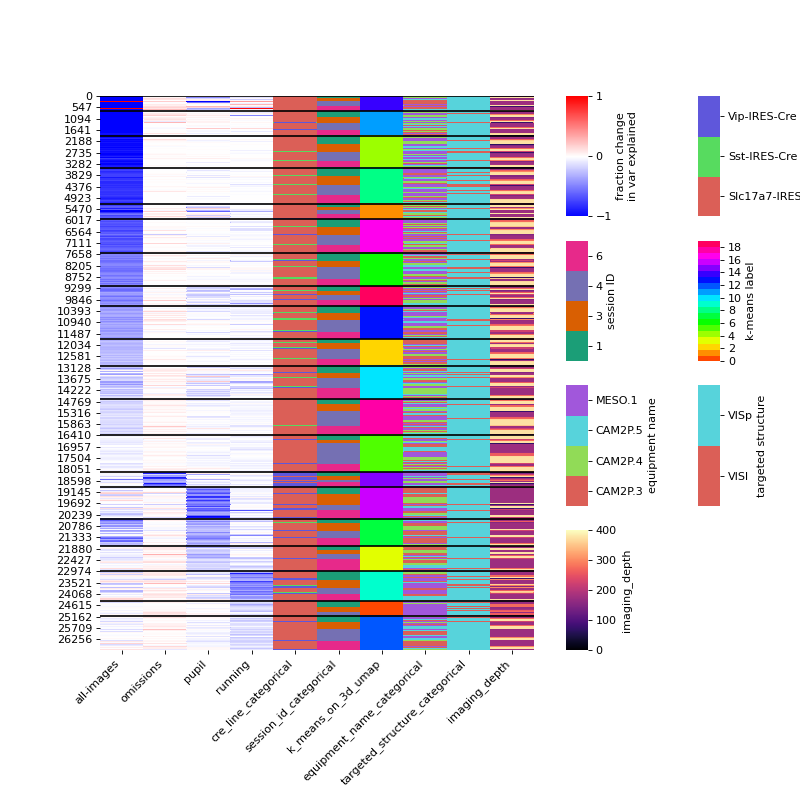

In [16]:
sort_order = ['dominant_dropout','dominant_dropout_median','session_id_categorical','cre_line_categorical','imaging_depth',]
sorted_data = gat.sort_data(rsp, sort_order, cluster_column_name='k_means_on_3d_umap')

fig, axes = vbp.make_multi_cmap_heatmap(
    sorted_data[cols_to_plot], 
    heatmap_defs, 
    figsize=(10,10), 
    top_buffer=0, 
    bottom_buffer=0.1, 
    n_cbar_rows=4, 
    heatmap_div=0.7, 
)
for idx,row in sorted_data.query('cluster_transition').iterrows():
    axes['heatmap'].axhline(idx,color='black')

## sort by structure after dropout

<IPython.core.display.Javascript object>


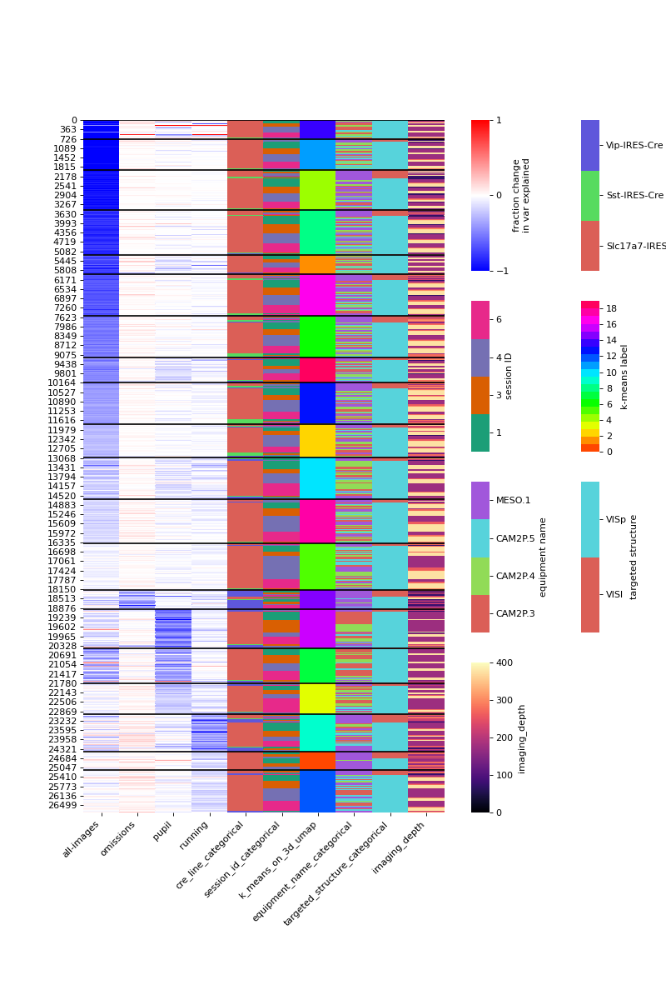

In [17]:
sort_order = ['dominant_dropout','dominant_dropout_median','targeted_structure_categorical','cre_line_categorical','session_id_categorical','imaging_depth']
sorted_data = gat.sort_data(rsp, sort_order, cluster_column_name='k_means_on_3d_umap')

fig, axes = vbp.make_multi_cmap_heatmap(
    sorted_data[cols_to_plot], 
    heatmap_defs, 
    figsize=(10,15), 
    top_buffer=0, 
    bottom_buffer=0.1, 
    n_cbar_rows=4, 
    heatmap_div=0.7, 
)
for idx,row in sorted_data.query('cluster_transition').iterrows():
    axes['heatmap'].axhline(idx,color='black')

## Sort by cluster ID and move it to the leftmost column

<IPython.core.display.Javascript object>


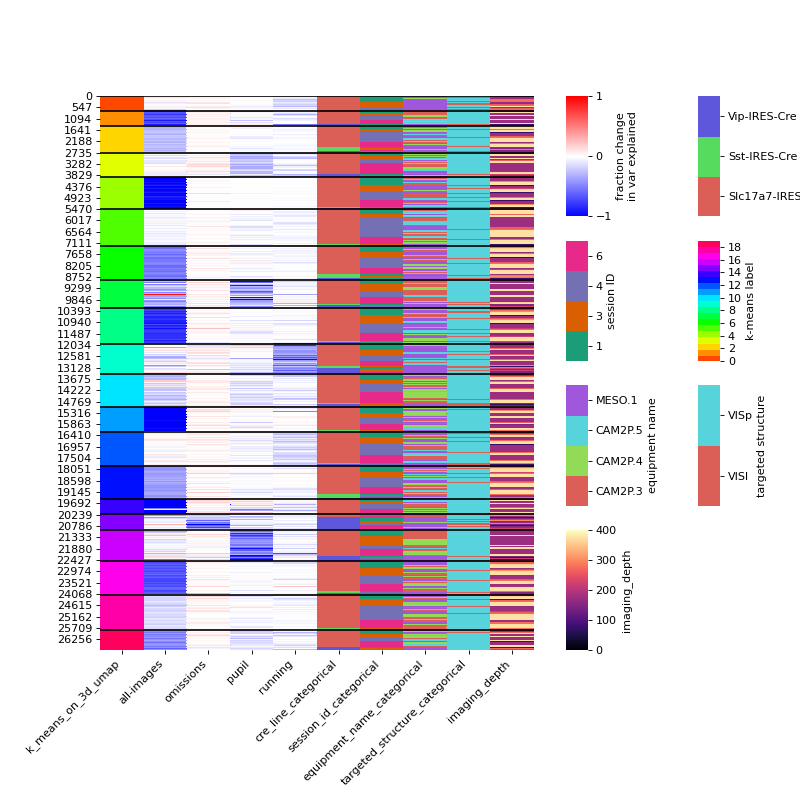

In [18]:
sort_order = ['k_means_on_3d_umap','cre_line_categorical','session_id_categorical','imaging_depth']
sorted_data = gat.sort_data(rsp, sort_order, cluster_column_name='k_means_on_3d_umap')

cols_to_plot = [
    'k_means_on_3d_umap', 
    'all-images', 
    'omissions', 
    'pupil', 
    'running',
    'cre_line_categorical', 
    'session_id_categorical', 
    'equipment_name_categorical',
    'targeted_structure_categorical',
    'imaging_depth'
]

fig, axes = vbp.make_multi_cmap_heatmap(
    sorted_data[cols_to_plot], 
    heatmap_defs, 
    figsize=(10,10), 
    top_buffer=0, 
    bottom_buffer=0.1, 
    n_cbar_rows=4, 
    heatmap_div=0.7, 
)
for idx,row in sorted_data.query('cluster_transition').iterrows():
    axes['heatmap'].axhline(idx,color='black')

## add pie charts for each cluster

Doc for pandas pie charts:
https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.plot.pie.html  

Note: It'd probably be better to normalize the values in the pie charts by their total number in in the dataset. For example, since there are far more Slc cells, they dominate every pie chart.

<IPython.core.display.Javascript object>


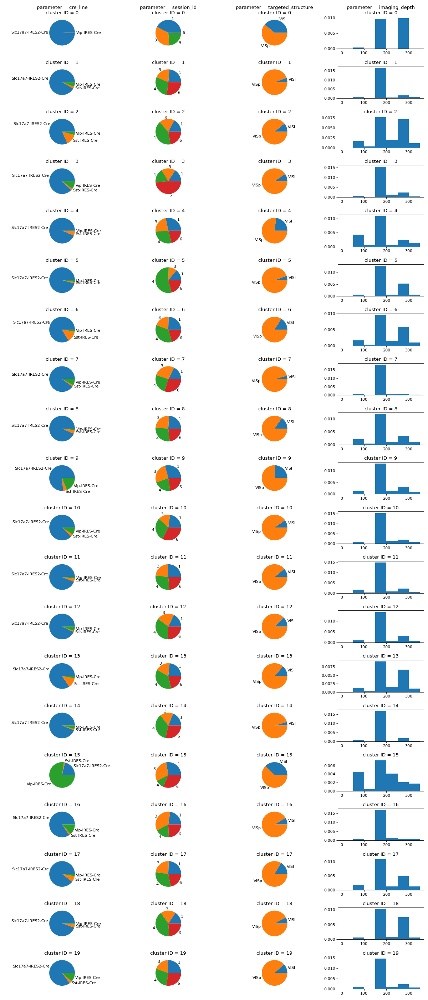

In [69]:
fig,ax = plt.subplots(20,4,figsize=(15,35))

parameters = ['cre_line','session_id','targeted_structure', 'imaging_depth']

for row,cluster_id in enumerate(sorted_data['k_means_on_3d_umap'].unique()):
    for col,parameter in enumerate(parameters):
        # make a histogram of imaging depths
        if parameter == 'imaging_depth':
            ax[row,col].hist(
                sorted_data.query('k_means_on_3d_umap == @cluster_id')['imaging_depth'],
                bins=np.arange(0,400,50),
                density=True
            )
            
        # make a pie chart for the rest
        else:
            # build a dataframe of value counts for the pie chart (there's probably a better way!)
            df = pd.DataFrame(sorted_data.query('k_means_on_3d_umap == @cluster_id')[parameter].value_counts()).sort_index()
            plot = df.plot.pie(
                y=parameter, 
                ax = ax[row,col],
                legend = False
            )
            ax[row,col].set_ylabel('')
        
        # set titles, make first row title different
        if row == 0:
            ax[row, col].set_title('parameter = {}\ncluster ID = {}'.format(parameter, cluster_id))
        else:
            ax[row, col].set_title('cluster ID = {}'.format(cluster_id))
            
            
fig.tight_layout()